<a href="https://colab.research.google.com/github/rahulpandey89/Age_and_Gender_Prediction/blob/master/table_extraction_using_detr.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install -q git+https://github.com/huggingface/transformers.git

!sudo apt install tesseract-ocr

!pip install -q timm pytesseract

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 49 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 1s (4,427 kB/s)
debconf: unable to initialize front

In [2]:
import matplotlib.pyplot as plt

%matplotlib inline

import numpy as np
import pandas as pd
import pytesseract
from pytesseract import Output

from huggingface_hub import hf_hub_download
from PIL import Image

import torch

from transformers import DetrFeatureExtractor
from transformers import TableTransformerForObjectDetection

In [3]:
feature_extractor = DetrFeatureExtractor()
model = TableTransformerForObjectDetection.from_pretrained("microsoft/table-transformer-structure-recognition")

/usr/local/lib/python3.10/dist-packages/transformers/models/detr/feature_extraction_detr.py:38: FutureWarning: The class DetrFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use DetrImageProcessor instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/1.47k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/115M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/46.8M [00:00<?, ?B/s]

Some weights of the model checkpoint at microsoft/table-transformer-structure-recognition were not used when initializing TableTransformerForObjectDetection: ['model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing TableTransformerForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TableTransformerForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [68]:
file_path='/content/img.png'
#file_path = hf_hub_download(repo_id="nielsr/example-pdf", repo_type="dataset", filename="example_table.png")
image = Image.open(file_path).convert("RGB")
width, height = image.size
image.resize((int(width*20), int(height*20)))

In [69]:
encoding = feature_extractor(image, return_tensors="pt")

with torch.no_grad():
  outputs = model(**encoding)

results = feature_extractor.post_process_object_detection(outputs, threshold=0.6,target_sizes=target_sizes)[0]
results

{'scores': tensor([0.9995, 0.9980, 0.9987, 0.9995, 0.9989, 0.9995, 0.9959, 0.9877, 0.9991,
         0.9998, 0.9985, 0.9984, 0.9668, 0.9998, 0.9998, 0.9981, 0.9943, 0.8274,
         0.9992, 0.9987, 0.9987, 0.9999]),
 'labels': tensor([2, 2, 2, 1, 2, 1, 2, 2, 2, 1, 2, 2, 2, 1, 1, 1, 2, 3, 1, 2, 2, 0]),
 'boxes': tensor([[ 15.5369, 140.4818, 441.6497, 160.3191],
         [ 15.9067, 240.2500, 441.6045, 259.9070],
         [ 15.7290,  80.3115, 441.8088, 100.1669],
         [298.2227,  22.1223, 356.7875, 277.6563],
         [ 15.2895, 120.1872, 441.5215, 140.0160],
         [230.5466,  22.1229, 297.9678, 277.6600],
         [ 15.6785,  60.6120, 441.7929,  80.4461],
         [ 15.7508,  41.0280, 441.8150,  60.5145],
         [ 15.4837, 100.0350, 441.7050, 120.0572],
         [ 15.5553,  22.0874,  89.1821, 277.5521],
         [ 15.5586, 160.7317, 441.7230, 180.6020],
         [ 15.6790, 220.1836, 441.5905, 240.2998],
         [ 15.6240,  21.8716, 441.5122,  40.9749],
         [357.2261,  21.92

In [70]:
label_dict = model.config.id2label
label_dict

{0: 'table',
 1: 'table column',
 2: 'table row',
 3: 'table column header',
 4: 'table projected row header',
 5: 'table spanning cell'}

In [71]:
results['labels']

tensor([2, 2, 2, 1, 2, 1, 2, 2, 2, 1, 2, 2, 2, 1, 1, 1, 2, 3, 1, 2, 2, 0])

In [72]:
labels, boxes = results['labels'], results['boxes']

column_header = None
table_rows = []
for label, (xmin, ymin, xmax, ymax) in zip(labels.tolist(), boxes.tolist()):
    label = label_dict[label]
    print(label)
    if label in ['table row', 'table column header']:
        cropped_image = image.crop((xmin, ymin, xmax, ymax))
        print(cropped_image )
        if label == "table column header":
            column_header = cropped_image
        else:
            table_rows.append(cropped_image)

table row
<PIL.Image.Image image mode=RGB size=426x20 at 0x7E6713D7FD90>
table row
<PIL.Image.Image image mode=RGB size=426x20 at 0x7E6713E5AB90>
table row
<PIL.Image.Image image mode=RGB size=426x20 at 0x7E672D7E6440>
table column
table row
<PIL.Image.Image image mode=RGB size=427x20 at 0x7E6713DF3DF0>
table column
table row
<PIL.Image.Image image mode=RGB size=426x19 at 0x7E6713F54A30>
table row
<PIL.Image.Image image mode=RGB size=426x20 at 0x7E6713D7FDF0>
table row
<PIL.Image.Image image mode=RGB size=427x20 at 0x7E6713D7E260>
table column
table row
<PIL.Image.Image image mode=RGB size=426x20 at 0x7E6713D7F2B0>
table row
<PIL.Image.Image image mode=RGB size=426x20 at 0x7E6713D7EFE0>
table row
<PIL.Image.Image image mode=RGB size=426x19 at 0x7E6713D7FCA0>
table column
table column
table column
table row
<PIL.Image.Image image mode=RGB size=426x18 at 0x7E6713D7F160>
table column header
<PIL.Image.Image image mode=RGB size=427x19 at 0x7E6713D7C790>
table column
table row
<PIL.Image.Im

In [81]:
column_header

In [80]:
table_rows[3]

In [74]:
import matplotlib.pyplot as plt

# colors for visualization
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

def plot_results(pil_img, scores, labels, boxes):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    for score, label, (xmin, ymin, xmax, ymax),c  in zip(scores.tolist(), labels.tolist(), boxes.tolist(), colors):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        text = f'{model.config.id2label[label]}: {score:0.2f}'
        ax.text(xmin, ymin, text, fontsize=15,
                bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

[(301, 480)]


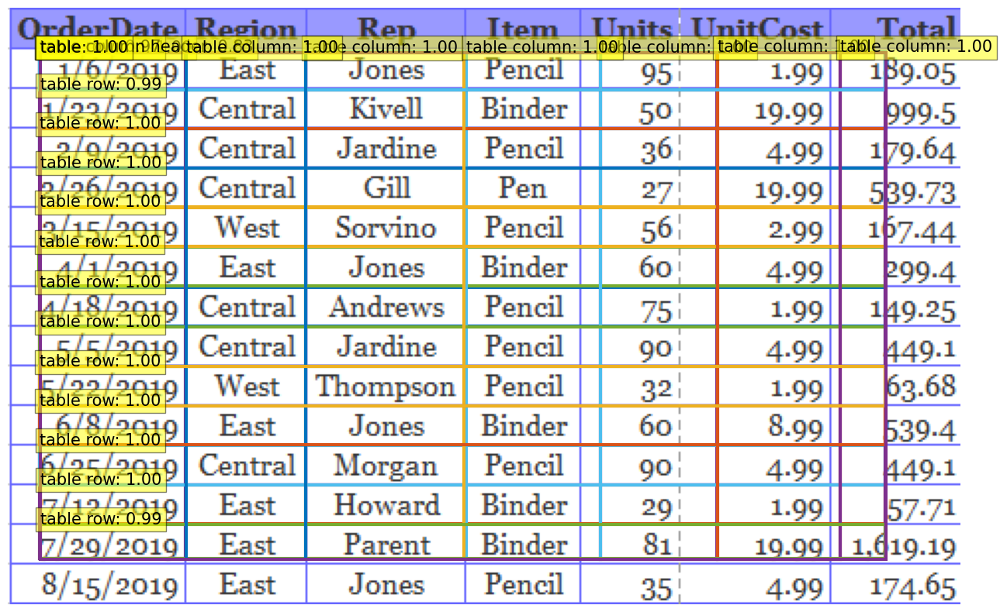

In [76]:
target_sizes = [image.size[::-1]]
print(target_sizes)
results = feature_extractor.post_process_object_detection(outputs, threshold=0.6, target_sizes=target_sizes)[0]
plot_results(image, results['scores'], results['labels'], results['boxes'])


In [77]:
ext_df = pytesseract.image_to_data(column_header, output_type=Output.DATAFRAME, config="--psm 1")
ext_df
ext_df = ext_df.dropna(subset=['text'])
#ext_df['text'] = ext_df['text'].str.strip()
ext_df = ext_df[ext_df['text'].apply(len) > 1]
ext_df = ext_df.reset_index(drop=True)
extracted_columns = ext_df['text'].values.tolist()
ext_result_df = pd.DataFrame(columns=list(map(lambda x: x, range(len(extracted_columns)))))
ext_result_df.columns = extracted_columns
ext_result_df

,1/6/2019|,East,Jones,


In [56]:
ext_df = pytesseract.image_to_data(column_header, output_type=Output.DATAFRAME, config="--psm 1")
ext_df

,level,page_num,block_num,par_num,line_num,word_num,left,top,width,height,conf,text
0,1,1,0,0,0,0,0,0,1824,57,-1,NaN


In [83]:
table_rows[0]

In [85]:
for table_row in table_rows:
    ext_df = pytesseract.image_to_data(table_row, output_type=Output.DATAFRAME, config="--psm 3")
    ext_df = ext_df.dropna(subset=['text'])
    # ext_df['text'] = ext_df['text'].str.strip()
    # ext_df = ext_df[ext_df['text'].apply(len) > 1]
    ext_df = ext_df.reset_index(drop=True)
    data = dict(zip(extracted_columns, ext_df['text'].values.tolist()))
    for col in extracted_columns:
        if col not in data:
            data[col] = np.nan
    row_df = pd.DataFrame(data=data, index=[0])
    ext_result_df = pd.concat([ext_result_df, row_df])

final_ext_df = pd.DataFrame()
for _, row in ext_result_df.iterrows():
    missing_count = row.isna().sum()
    if missing_count // len(ext_result_df.columns) == 1:
        continue
    row_df = pd.DataFrame(row).T
    final_ext_df = pd.concat([final_ext_df, row_df])

final_ext_df = final_ext_df.reset_index(drop=True)
final_ext_df.head()

,1/6/2019|,East,Jones,
0,,4/18/2019|,Central|,Andrews
1,7/12/2019),East,|,Howard
2,,2/26/2019|,Central,
3,,4/1/2019|,East,|
4,2/9/2019|,Central},Jardine,|
